# Supermarket Sales Prediction (Time Serires Problem)

 Koristicemo pytorch za kreiranje neuronskih mreza koje cemo koristiti za predvidjanje i hvatanje kompleksnih obrazaca u toku vremena. Plan je da koristimo Multilayer Perceptron model i LSTM koji pamti prosle vrijednosti u nadi da ce dati bolje rezultate.

#### 1. Prvo uradimo import svih biblioteka koje cemo korisiti u nastavku i ucitamo podatke na kojima cemo trenirati/testirati nas model


In [52]:
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
import plotly as plt
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot

from numpy.random import seed

In [53]:
torch.manual_seed(123)
seed(123)

Ucitavamo podatke

In [54]:
train = pd.read_csv("./train.csv", parse_dates=['date'])
test = pd.read_csv("./test.csv", parse_dates=['date'])

statisticke vrijednosti train dataseta

In [55]:
train.describe()

,date,store,item,sales
count,913000,913000.000000,913000.000000,913000.000000
mean,2015-07-02 11:59:59.999999744,5.500000,25.500000,52.250287
min,2013-01-01 00:00:00,1.000000,1.000000,0.000000
25%,2014-04-02 00:00:00,3.000000,13.000000,30.000000
50%,2015-07-02 12:00:00,5.500000,25.500000,47.000000
75%,2016-10-01 00:00:00,8.000000,38.000000,70.000000
max,2017-12-31 00:00:00,10.000000,50.000000,231.000000
std,NaN,2.872283,14.430878,28.801144


imamo trainset od 4 godine

In [56]:
print('Min date from train set: ',  train['date'].min().date())
print('Max date from train set: ',  train['date'].max().date())

Min date from train set:  2013-01-01
Max date from train set:  2017-12-31


### 2. Test dio cemo koristiti na samom kraju za evaluaciju nasih modela

In [57]:
lag_size = (test['date'].max().date() - train['date'].max().date()).days
print('Max date from train set: %s' % train['date'].max().date())
print('Max date from test set: %s' % test['date'].max().date())
print('Forecast lag size', lag_size)

Max date from train set: 2017-12-31
Max date from test set: 2018-03-31
Forecast lag size 90


In [58]:
columns = train.columns
columns

Index(['date', 'store', 'item', 'sales'], dtype='object')

In [59]:

daily_sales = train.groupby('date', as_index=False)['sales'].sum()
print(daily_sales.shape)
daily_sales.head()

(1826, 2)


,date,sales
0,2013-01-01,13696
1,2013-01-02,13678
2,2013-01-03,14488
3,2013-01-04,15677
4,2013-01-05,16237


In [60]:
sales_by_store = train.groupby(by=['date', 'store'], as_index=False)['sales'].sum()
item_daily_sales = train.groupby(['item', 'date'], as_index=False)['sales'].sum()
# print(item_daily_sales.head())
sales_by_store.head()

,date,store,sales
0,2013-01-01,1,1316
1,2013-01-01,2,1742
2,2013-01-01,3,1588
3,2013-01-01,4,1423
4,2013-01-01,5,1032


### 3. Vizualizujemo podatke da vidimo bolje sta nam je cilj predvidjanja
Ukupna prodaja u lancu marketa po danima. Uocavamo neke sablone

In [61]:
daily_sales_sc = go.Scatter(x = daily_sales['date'], y = daily_sales['sales'])
layout = go.Layout(title='Daily sales', xaxis=dict(title='Date'), yaxis=dict(title='Sales'))
fig = go.Figure(data=[daily_sales_sc], layout=layout)
iplot(fig)

Prodaja po prodavnci. Ovi plotovi su iskljucivo za bolje razumjevanje podataka i problema. Nas krajnji cilj je da npravimo generalnu predikciju za prodaju nekog proizvoda u nekoj prodavnici i generalnu predikciju prodaje.

In [62]:
store_daily_sales_sc = []
for store in sales_by_store['store'].unique():
    current_store_daily_sales = sales_by_store[(sales_by_store['store'] == store)]
    store_daily_sales_sc.append(go.Scatter(x=current_store_daily_sales['date'], y=current_store_daily_sales['sales'], name=('Store %s' % store)))

layout = go.Layout(title='Store daily sales', xaxis=dict(title='Date'), yaxis=dict(title='Sales'))
fig = go.Figure(data=store_daily_sales_sc, layout=layout)
iplot(fig)

Najpopularniji artikli tokom vremena. Ovaj kod kreira interaktivni linijski graf dnevne prodaje za svaki artikl. Za svaki jedinstveni artikl u podacima filtrira se njegov niz prodaje po datumima i dodaje u graf kao zasebna linija. Osa x prikazuje datume, osa y broj prodatih jedinica, a legenda označava koji artikl pripada kojoj liniji. Na kraju se graf prikazuje unutar notebook-a koristeći Plotly, omogućavajući pregled i usporedbu trendova prodaje svih artikala kroz vrijeme.

In [63]:
item_daily_sales_sc = []
for item in item_daily_sales['item'].unique():
    current_item_daily_sales = item_daily_sales[(item_daily_sales['item'] == item)]
    item_daily_sales_sc.append(go.Scatter(x=current_item_daily_sales['date'], y=current_item_daily_sales['sales'], name=('Item %s' % item)))

layout = go.Layout(title='Item daily sales', xaxis=dict(title='Date'), yaxis=dict(title='Sales'))
fig = go.Figure(data=item_daily_sales_sc, layout=layout)
iplot(fig)

Ovdje smo smanjili dataset samo zato da bi testirali nase modele da nam model ne bi oduzimao puno vremena na treniranje. Zavrsni model bi trebao da bude treniran na cjelokupnom datasetu! Testirano je i model je treniran i na vecem i na manjem skupu podataka uspjesno ali bolji rezultati su kada imamo vise podataka.

In [64]:
# train = train[(train['date'] >= '2017-01-01')]
train.shape, test.shape

((913000, 4), (45000, 4))

In [65]:
train_gp = train.sort_values('date').groupby(['item', 'store', 'date'], as_index=False)
train_gp = train_gp.agg({'sales':['mean']})
train_gp.columns = ['item', 'store', 'date', 'sales']
print(train_gp.shape)
train_gp.head()

(913000, 4)


,item,store,date,sales
0,1,1,2013-01-01,13.0
1,1,1,2013-01-02,11.0
2,1,1,2013-01-03,14.0
3,1,1,2013-01-04,13.0
4,1,1,2013-01-05,10.0


### 4. Cilj je napraviti dataframe koji ce imati time series strukturu
Struktura treba da bude takva da uzmemo zadnjih n dana i predvidjamo n+1. Za n cemo uzeti 29 koji treba da simulira zadnji mjesec jer smo mogli iz plotova da vidimo neke podudarnosti svakog mjeseca.

Cilj ovog koraka je transformisati originalni skup podataka u oblik pogodnan za modeliranje vremenskih serija.

* Svaki red u novom DataFrame-u predstavlja jednu vremensku sekvencu za određeni `store-item` par.
* Features (ulazi) su prodaje za prethodnih n dana, dok je target (izlaz) prodaja za naredni dan (n+1).

Odlučili smo uzeti n = 29, što simulira približno posljednji mjesec prodaje.

* Ova odluka proizlazi iz analize podataka i vizualizacija, gdje se mogu uočiti mjesečni obrasci i sezonalnosti.
* Na taj način model može učiti obrasce koji se ponavljaju u okviru jednog mjeseca, poput ponedjeljaka sa slabijom prodajom, vikenda sa višom prodajom, ili drugih mjesečnih trendova.

In [66]:
def series_to_supervised(data, window=1, lag=1, dropnan=True):
    print(data.head())
    cols, names = list(), list()
    # Input sequence (t-n, ... t-1)
    for i in range(window, 0, -1):
        cols.append(data.shift(i))
        names += [('%s(t-%d)' % (col, i)) for col in data.columns]
    # Current timestep (t=0)
    cols.append(data)
    names += [('%s(t)' % (col)) for col in data.columns]
    # Target timestep (t=lag)
    cols.append(data.shift(-lag))
    names += [('%s(t+%d)' % (col, lag)) for col in data.columns]
    # Put it all together
    agg = pd.concat(cols, axis=1)
    agg.columns = names
    # Drop rows with NaN values
    if dropnan:
        agg.dropna(inplace=True)
    return agg

In [67]:
window = 29
lag = lag_size
print(train_gp.shape)
print(train_gp.head())
series = series_to_supervised(train_gp.drop('date', axis=1), window=window, lag=lag)
print(len(series))
series.head()

(913000, 4)
   item  store       date  sales
0     1      1 2013-01-01   13.0
1     1      1 2013-01-02   11.0
2     1      1 2013-01-03   14.0
3     1      1 2013-01-04   13.0
4     1      1 2013-01-05   10.0
   item  store  sales
0     1      1   13.0
1     1      1   11.0
2     1      1   14.0
3     1      1   13.0
4     1      1   10.0
912881


,item(t-29),store(t-29),sales(t-29),item(t-28),store(t-28),sales(t-28),item(t-27),store(t-27),sales(t-27),item(t-26),...,sales(t-2),item(t-1),store(t-1),sales(t-1),item(t),store(t),sales(t),item(t+90),store(t+90),sales(t+90)
29,1.0,1.0,13.0,1.0,1.0,11.0,1.0,1.0,14.0,1.0,...,11.0,1.0,1.0,6.0,1,1,9.0,1.0,1.0,15.0
30,1.0,1.0,11.0,1.0,1.0,14.0,1.0,1.0,13.0,1.0,...,6.0,1.0,1.0,9.0,1,1,13.0,1.0,1.0,16.0
31,1.0,1.0,14.0,1.0,1.0,13.0,1.0,1.0,10.0,1.0,...,9.0,1.0,1.0,13.0,1,1,11.0,1.0,1.0,23.0
32,1.0,1.0,13.0,1.0,1.0,10.0,1.0,1.0,12.0,1.0,...,13.0,1.0,1.0,11.0,1,1,21.0,1.0,1.0,22.0
33,1.0,1.0,10.0,1.0,1.0,12.0,1.0,1.0,10.0,1.0,...,11.0,1.0,1.0,21.0,1,1,15.0,1.0,1.0,20.0


Ovdje sklanjamo duplikate i stvari koje nam nisu potrebne. Pravimo `item-store` parove ali kako nasem modelu eksplicitno ne trebaju store i item id njih cemo skloniti.

In [68]:
last_item = 'item(t-%d)' % window
last_store = 'store(t-%d)' % window
series = series[(series['store(t+%d)' % lag] == series[last_store])]
series = series[(series['item(t+%d)'  % lag] == series[last_item ])]

series = series[(series['store(t)'] == series[last_store])]
series = series[(series['item(t)'] == series[last_item])]
# print(series.shape)

# series = series[(series['store(t)'] == 1)]
# series = series[(series['item(t)'] == 1)]
print(series.shape)
series.head()

(853500, 93)


,item(t-29),store(t-29),sales(t-29),item(t-28),store(t-28),sales(t-28),item(t-27),store(t-27),sales(t-27),item(t-26),...,sales(t-2),item(t-1),store(t-1),sales(t-1),item(t),store(t),sales(t),item(t+90),store(t+90),sales(t+90)
29,1.0,1.0,13.0,1.0,1.0,11.0,1.0,1.0,14.0,1.0,...,11.0,1.0,1.0,6.0,1,1,9.0,1.0,1.0,15.0
30,1.0,1.0,11.0,1.0,1.0,14.0,1.0,1.0,13.0,1.0,...,6.0,1.0,1.0,9.0,1,1,13.0,1.0,1.0,16.0
31,1.0,1.0,14.0,1.0,1.0,13.0,1.0,1.0,10.0,1.0,...,9.0,1.0,1.0,13.0,1,1,11.0,1.0,1.0,23.0
32,1.0,1.0,13.0,1.0,1.0,10.0,1.0,1.0,12.0,1.0,...,13.0,1.0,1.0,11.0,1,1,21.0,1.0,1.0,22.0
33,1.0,1.0,10.0,1.0,1.0,12.0,1.0,1.0,10.0,1.0,...,11.0,1.0,1.0,21.0,1,1,15.0,1.0,1.0,20.0


In [69]:
columns_to_drop = [('%s(t+%d)' % (col, lag)) for col in ['item', 'store']]
for i in range(window, 0, -1):
    columns_to_drop += [('%s(t-%d)' % (col, i)) for col in ['item', 'store']]
series.drop(columns_to_drop, axis=1, inplace=True)
series.drop(['item(t)', 'store(t)'], axis=1, inplace=True)
print(series.shape)
series.head()

(853500, 31)


,sales(t-29),sales(t-28),sales(t-27),sales(t-26),sales(t-25),sales(t-24),sales(t-23),sales(t-22),sales(t-21),sales(t-20),...,sales(t-8),sales(t-7),sales(t-6),sales(t-5),sales(t-4),sales(t-3),sales(t-2),sales(t-1),sales(t),sales(t+90)
29,13.0,11.0,14.0,13.0,10.0,12.0,10.0,9.0,12.0,9.0,...,7.0,9.0,8.0,14.0,12.0,12.0,11.0,6.0,9.0,15.0
30,11.0,14.0,13.0,10.0,12.0,10.0,9.0,12.0,9.0,9.0,...,9.0,8.0,14.0,12.0,12.0,11.0,6.0,9.0,13.0,16.0
31,14.0,13.0,10.0,12.0,10.0,9.0,12.0,9.0,9.0,7.0,...,8.0,14.0,12.0,12.0,11.0,6.0,9.0,13.0,11.0,23.0
32,13.0,10.0,12.0,10.0,9.0,12.0,9.0,9.0,7.0,10.0,...,14.0,12.0,12.0,11.0,6.0,9.0,13.0,11.0,21.0,22.0
33,10.0,12.0,10.0,9.0,12.0,9.0,9.0,7.0,10.0,12.0,...,12.0,12.0,11.0,6.0,9.0,13.0,11.0,21.0,15.0,20.0


In [70]:
# Label
labels_col = 'sales(t+%d)' % lag_size
labels = series[labels_col]
series = series.drop(labels_col, axis=1)
# print(labels.values)

X_train, X_valid, Y_train, Y_valid = train_test_split(series, labels.values, test_size=0.4, random_state=0)
print('Train set shape', X_train.shape)
print('Validation set shape', X_valid.shape)
print(Y_train.shape)
# print(X_train[:10], Y_train[29:60])

Train set shape (512100, 30)
Validation set shape (341400, 30)
(512100,)


### 5. Pretvaramo df u unumpy niz i skaliramo vrijednost izmedju -1,1 jer takve vrijednosti bolje rade sa neuronima nego obicne vrijednosti.

In [110]:
print(series.shape)
series.head()

series_as_np_not_scaled = series.to_numpy()

series_as_np_not_scaled

(853500, 30)


array([[ 13.,  11.,  14., ...,  11.,   6.,   9.],
       [ 11.,  14.,  13., ...,   6.,   9.,  13.],
       [ 14.,  13.,  10., ...,   9.,  13.,  11.],
       ...,
       [ 96.,  92., 102., ...,  82.,  90., 103.],
       [ 92., 102.,  60., ...,  90., 103.,  99.],
       [102.,  60.,  81., ..., 103.,  99.,  71.]])

In [111]:
# skaliramo vrijednosti od -1 do 1
from sklearn.preprocessing import MinMaxScaler

print(series_as_np_not_scaled.shape)

scaler = MinMaxScaler(feature_range=(-1,1))
series_as_np = scaler.fit_transform(series_as_np_not_scaled)

series_as_np

(853500, 30)


array([[-0.88744589, -0.9047619 , -0.87878788, ..., -0.9047619 ,
        -0.94805195, -0.92207792],
       [-0.9047619 , -0.87878788, -0.88744589, ..., -0.94805195,
        -0.92207792, -0.88744589],
       [-0.87878788, -0.88744589, -0.91341991, ..., -0.92207792,
        -0.88744589, -0.9047619 ],
       ...,
       [-0.16883117, -0.2034632 , -0.11688312, ..., -0.29004329,
        -0.22077922, -0.10822511],
       [-0.2034632 , -0.11688312, -0.48051948, ..., -0.22077922,
        -0.10822511, -0.14285714],
       [-0.11688312, -0.48051948, -0.2987013 , ..., -0.10822511,
        -0.14285714, -0.38528139]])

### 6. Dijelimo train set na 2 dijela kako bi validirali nas model prilikom treniranja

In [116]:
# i pravimo X i Y
X = series_as_np[:, 1:]
Y = series_as_np[:, 0]
print(X.shape, Y.shape)

# train and test
split_index = int(len(X)*0.8)
split_index

X_train = X[:split_index]
X_test = X[split_index:]

Y_train = Y[:split_index]
Y_test = Y[split_index:]

X_train.shape, Y_train.shape, X_test.shape, Y_test.shape

(853500, 29) (853500,)


((682800, 29), (682800,), (170700, 29), (170700,))

Dodajemo ekstra dimenziju jer je ona potrebna za LSTM model.

In [117]:
print(X_train.shape, X_test.shape, Y_train.shape, Y_test.shape)
X_train = X_train.reshape((-1, window, 1))
X_test = X_test.reshape((-1, window, 1))

Y_train = Y_train.reshape((-1, 1))
Y_test = Y_test.reshape((-1, 1))

X_train.shape, X_test.shape, Y_train.shape, Y_test.shape

(682800, 29) (170700, 29) (682800,) (170700,)


((682800, 29, 1), (170700, 29, 1), (682800, 1), (170700, 1))

### MODEL 0
Prvi model je jednostavniji i ne gleda prosle vrijednosti vec dobija input i predvidja rezultat. Ne uzima u obzir prethodne vrijednosti potencijalno bitne za time series problem. Imamo 2 linearna sloja koji izmedju sebe imaju ReLU aktivacionu funkciju.

In [75]:
# model 0
from torch import nn
class Model0(nn.Module):
  def __init__(self,input_shape:int, hidden_units: int, output_shape: int) -> None:
    super().__init__()
    self.block = nn.Sequential(
        nn.Linear(
                  in_features=input_shape,
                  out_features=hidden_units
                  ),
        nn.ReLU(),
        nn.Linear(
                  in_features=hidden_units,
                  out_features=output_shape,
              ),
    )

  def forward(self, x):
    x = self.block(x)
    return x

Funkcija za treniranje koja radi po principu:
1. Iterira kroz svaki batch
2. Iz trenutnog modela uzme predvidjene vrijednosti `y_pred`
3. Izracuna `loss` pomocu `loss_fn`
4. Sabira `loss` za trenutni korak
5. Radi backpropagation kako bi podesio vrijednosti neurona i smanjio loss `loss.backward()` sa takvom izracunatom vrijednosti `optimizer.step()` setuje nove vrijednosti neurona
6. Dalje radimo print trenutnog stanja i vracamo gubitke.

In [76]:
device = "cuda" if torch.cuda.is_available() else "cpu"

def train_step(model:nn.Module,
               dataloader: torch.utils.data.DataLoader,
               loss_fn: torch.nn.Module,
               optimizer: torch.nn.Module,
               device=device,
               model_type = "LSTM"
                ):
  model.train()

  train_loss, train_mae = 0,0

  for batch_idx, (X,y) in enumerate(dataloader):
    X,y = X.to(device),  y.to(device).view(-1, 1)
    if model_type != "LSTM":
      X = X.view(X.size(0), -1)


    y_pred = model(X)

    loss = loss_fn(y_pred, y)

    train_loss += loss.item()

    optimizer.zero_grad()

    loss.backward()
    optimizer.step()

    if batch_idx % 100 == 0:
            avg_loss_across_batches = train_loss
            print('Batch {0}, Loss: {1:.3f}'.format(batch_idx+1,
                                                    avg_loss_across_batches))
            train_loss = 0.0

    batch_mae = torch.mean(torch.abs(y_pred - y)).item()
    train_mae += batch_mae

  return train_loss, train_mae

Validaciona funkcija koja se koristi u treningu

In [77]:
def validate_epoch(model,dataloader,loss_fn,device=device, model_type = "LSTM"):
    model.eval()
    running_loss = 0.0

    with torch.no_grad():
      for batch_index, batch in enumerate(dataloader):
            x_batch, y_batch = batch[0].to(device), batch[1].to(device)
            if model_type != "LSTM":
              x_batch = x_batch.view(x_batch.size(0), -1)

            output = model(x_batch)
            loss = loss_fn(output, y_batch)
            running_loss += loss.item()

    avg_loss_across_batches = running_loss / len(dataloader)

    print('Val Loss: {0:.3f}'.format(avg_loss_across_batches))
    print('***************************************************')
    print()

Train model uzima prosledjene parametre i trenira nas model. S ovom metodom smo olaksali treniranje modela i napravili univerzalnu funkciju za treniranje koja se moze pozivati za svaki model. Trenutno ovdje fali validacioni dio.

In [78]:
from tqdm.auto import tqdm

def train_model(model:nn.Module,
                train_data:torch.utils.data.DataLoader,
                test_data: torch.utils.data.DataLoader,
                optimizer,
                loss_fn: nn.Module = nn.CrossEntropyLoss(),
                epochs:int = 5,
                device=device,
                model_type = "LSTM"):
  model_dictionary = {
      "train_loss": [],
      "train_acc": [],
      "test_loss":[],
      "test_acc": []
  }


  for epoch in tqdm(range(epochs)):
    train_loss, train_acc = train_step(model=model,
                                      dataloader=train_data,
                                      loss_fn=loss_fn,
                                      optimizer=optimizer,
                                      device=device,
                                      model_type=model_type
                                     )
    print(f"Epoch: {epoch}, loss: {train_loss}, accuracy: {train_acc}")
    validate_epoch(model,test_data, loss_fn,device, model_type=model_type)



    model_dictionary["train_loss"].append(train_loss)
    model_dictionary["train_acc"].append(train_acc)
  return model_dictionary


Pretvaramo podatke u tenzore jer pytorch radi u tom formatu.

In [114]:
from torch.utils.data import TensorDataset
tensor_X_train = torch.tensor(X_train, dtype=torch.float32)
tensor_Y_train = torch.tensor(Y_train, dtype=torch.float32)

tensor_X_test = torch.tensor(X_test, dtype=torch.float32)
tensor_Y_test = torch.tensor(Y_test, dtype=torch.float32)


tensor_X_train.shape, tensor_X_test.shape, tensor_Y_train.shape, tensor_Y_test.shape

# train_dataset = TensorDataset(tensor_X_train, tensor_Y_train)
# train_dataset
print(X_train[0].shape)

(29, 1)


Custom class reprezentuje nas dataset koristi se za dataloader posle i enkapsulira nase podatke. Nije neophodno ali je lakse raditi ovako.

In [80]:
from torch.utils.data import Dataset

class TimeSeriesDataset(Dataset):
    def __init__(self, X, y):
        self.X = X
        self.y = y

    def __len__(self):
        return len(self.X)

    def __getitem__(self, i):
        return self.X[i], self.y[i]

train_dataset = TimeSeriesDataset(tensor_X_train, tensor_Y_train)
test_dataset = TimeSeriesDataset(tensor_X_test, tensor_Y_test)

Instanciramo model, optimizer, i loss funkciju.
# TODO: opisi zasto se koristi loss, opt i zasto bas njih

In [118]:
# 1. MLP
from torch.optim import Adam
print(tensor_X_train.shape[1])
print(tensor_X_train.shape)
batch = 256
model_0 = Model0(input_shape=tensor_X_train.shape[1], hidden_units=batch, output_shape=1)
epochs = 40
lr = 0.0003
loss_fn = nn.MSELoss()
optimizer = torch.optim.SGD(params = model_0.parameters(), lr=lr)

29
torch.Size([682800, 29, 1])


In [82]:
torch.manual_seed(42)
torch.cuda.manual_seed(42)

from timeit import default_timer as timer
from torch.utils.data import DataLoader
import os

NUM_WORKERS = os.cpu_count()

train_dataloader = DataLoader(
    dataset = train_dataset,
    batch_size = batch,
    shuffle = True,
    num_workers = NUM_WORKERS,
)
test_dataloader = DataLoader(
    dataset = test_dataset,
    batch_size = batch,
    shuffle = True,
    num_workers = NUM_WORKERS
)


## Treniranje nultog modela


Ovaj model je jednostavna feedforward neuronska mreža za regresiju.

Ulazni sloj prima vektor od n prethodnih dana prodaje, zatim prolazi kroz skriveni linearni sloj sa ReLU aktivacijom, i izlazni linearni sloj predviđa prodaju za naredni dan. Model uči obrasce iz prošlih podataka, ali ne pamti sekvencijalne veze kao LSTM, pa je jednostavan i brz za treniranje.

Zbog svega iznad sto smo postavili, nase treniranje modela je samo poziv jedne funkcije.

Ovo ce nam biti baseline model i od njega krecemo sa ciljem da ce sledeci modeli dati bolje rezultate od `modela 0`

In [83]:
start_time = timer()

model0_results = train_model(model=model_0.to(device),
            train_data=train_dataloader,
            test_data = test_dataloader,
            loss_fn=loss_fn,
            optimizer=optimizer,
            epochs = 5,
            device = device,
            model_type="linear"
            )
end_time = timer()

print(f"Total training time: {end_time - start_time}")

  0%|          | 0/5 [00:00<?, ?it/s]

Batch 1, Loss: 0.460
Batch 101, Loss: 18.364
Batch 201, Loss: 2.600
Batch 301, Loss: 1.073
Batch 401, Loss: 0.910
Batch 501, Loss: 0.881
Batch 601, Loss: 0.898
Batch 701, Loss: 0.884
Batch 801, Loss: 0.884
Batch 901, Loss: 0.887
Batch 1001, Loss: 0.874
Batch 1101, Loss: 0.902
Batch 1201, Loss: 0.892
Batch 1301, Loss: 0.869
Batch 1401, Loss: 0.879
Batch 1501, Loss: 0.888
Batch 1601, Loss: 0.869
Batch 1701, Loss: 0.879
Batch 1801, Loss: 0.869
Batch 1901, Loss: 0.869
Batch 2001, Loss: 0.873
Batch 2101, Loss: 0.870
Batch 2201, Loss: 0.870
Batch 2301, Loss: 0.854
Batch 2401, Loss: 0.870
Batch 2501, Loss: 0.877
Batch 2601, Loss: 0.846
Epoch: 0, loss: 0.569234770257026, accuracy: 226.78426749259233
Val Loss: 0.006
***************************************************

Batch 1, Loss: 0.009
Batch 101, Loss: 0.851
Batch 201, Loss: 0.857
Batch 301, Loss: 0.865
Batch 401, Loss: 0.849
Batch 501, Loss: 0.867
Batch 601, Loss: 0.839
Batch 701, Loss: 0.844
Batch 801, Loss: 0.840
Batch 901, Loss: 0.841
Ba

Prvo cemo uraditi vizualizaciju validacionog dijela train seta i nasih predvidjanja. Vizualizacija je jako prosta. Poredimo stvarne vrijednosti sa predvidjanjima.

Ovo je spoj prodaje iz svih prodavnica i za sve iteme, sluzice nam samo da vidimo koliko je nasa narandzasta linija pokrila plavih a u nastavku cemo napraviti preciznije vizualizacije.

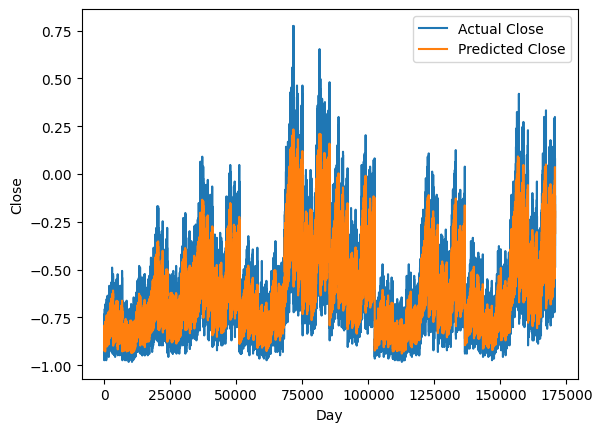

In [84]:
# # validate res
import matplotlib.pyplot as plt

X = tensor_X_test.view(tensor_X_test.size(0), -1)
X.shape
model_0.to('cpu')
with torch.no_grad():
    predicted = model_0(X).to('cpu').numpy()


plt.plot(tensor_Y_test.to('cpu').numpy(), label='Actual Close')
plt.plot(predicted, label='Predicted Close')
plt.xlabel('Day')
plt.ylabel('Close')
plt.legend()
plt.show()

# Model 2

Ovaj model je `LSTM neuronska mreža` namijenjena za predikciju vremenskih serija, poput dnevne prodaje.

LSTM sloj prima ulazni vektor veličine input_size i prolazi kroz num_stacked_layers slojeva sa hidden_size jedinica, čuvajući sekvencijalne informacije iz prethodnih dana.

* Inicijalizacija hidden i cell stanja (h0 i c0) postavlja početna stanja na nulu za svaki batch.
* Output sloj (fc) predviđa vrijednost narednog dana na osnovu posljednjeg vremenskog koraka iz LSTM-a.

Model uči obrasce kroz vrijeme, za razliku od feedforward mreže, i bolje hvata temporalne zavisnosti i trendove u podacima.

Ovaj model je treniran sa 1 ulazom, hidden_size=256 i jednim LSTM slojem.

In [85]:
# LSTM MODEL 2
class LSTM(nn.Module):
    def __init__(self, input_size, hidden_size, num_stacked_layers):
        super().__init__()
        self.hidden_size = hidden_size
        self.num_stacked_layers = num_stacked_layers

        self.lstm = nn.LSTM(input_size, hidden_size, num_stacked_layers,
                            batch_first=True)

        self.fc = nn.Linear(hidden_size, 1)

    def forward(self, x):
        batch_size = x.size(0)
        h0 = torch.zeros(self.num_stacked_layers, batch_size, self.hidden_size).to(x.device)
        c0 = torch.zeros(self.num_stacked_layers, batch_size, self.hidden_size).to(x.device)

        out, _ = self.lstm(x, (h0, c0))
        out = self.fc(out[:, -1, :])
        return out


model_1 = LSTM(1, 256, 1)
model_1.to(device)
model_1

LSTM(
  (lstm): LSTM(1, 256, batch_first=True)
  (fc): Linear(in_features=256, out_features=1, bias=True)
)

### Ponavljamo treniranje modela na isti nacin. I gledamo rezultate.

In [86]:
learning_rate = 0.001
num_epochs = 20
loss_function = nn.MSELoss()
optimizer = torch.optim.Adam(model_1.parameters(), lr=learning_rate)

for epoch in tqdm(range(num_epochs)):
    train_step(model=model_1.to(device),
               dataloader=train_dataloader,
               loss_fn=loss_function,
               optimizer=optimizer,
               device=device
              )
    validate_epoch(model_1,test_dataloader, loss_function,device)

  0%|          | 0/20 [00:00<?, ?it/s]

Batch 1, Loss: 0.386
Batch 101, Loss: 3.922
Batch 201, Loss: 1.087
Batch 301, Loss: 1.063
Batch 401, Loss: 1.063
Batch 501, Loss: 0.997
Batch 601, Loss: 1.024
Batch 701, Loss: 1.001
Batch 801, Loss: 0.961
Batch 901, Loss: 0.919
Batch 1001, Loss: 0.852
Batch 1101, Loss: 0.819
Batch 1201, Loss: 0.795
Batch 1301, Loss: 0.798
Batch 1401, Loss: 0.786
Batch 1501, Loss: 0.744
Batch 1601, Loss: 0.727
Batch 1701, Loss: 0.713
Batch 1801, Loss: 0.704
Batch 1901, Loss: 0.683
Batch 2001, Loss: 0.662
Batch 2101, Loss: 0.628
Batch 2201, Loss: 0.635
Batch 2301, Loss: 0.623
Batch 2401, Loss: 0.608
Batch 2501, Loss: 0.601
Batch 2601, Loss: 0.594
Val Loss: 0.005
***************************************************

Batch 1, Loss: 0.006
Batch 101, Loss: 0.621
Batch 201, Loss: 0.580
Batch 301, Loss: 0.580
Batch 401, Loss: 0.589
Batch 501, Loss: 0.580
Batch 601, Loss: 0.585
Batch 701, Loss: 0.584
Batch 801, Loss: 0.568
Batch 901, Loss: 0.580
Batch 1001, Loss: 0.585
Batch 1101, Loss: 0.566
Batch 1201, Loss: 0

Opet ponavljamo isti tip vizualizacije.

Ovo je spoj prodaje iz svih prodavnica i za sve iteme, sluzice nam samo da vidimo koliko je nasa narandzasta linija pokrila plavih a u nastavku cemo napraviti preciznije vizualizacije.

I sada vidimo da je ovaj model vec bolji (po odnosu narandzastih i plavih linija)

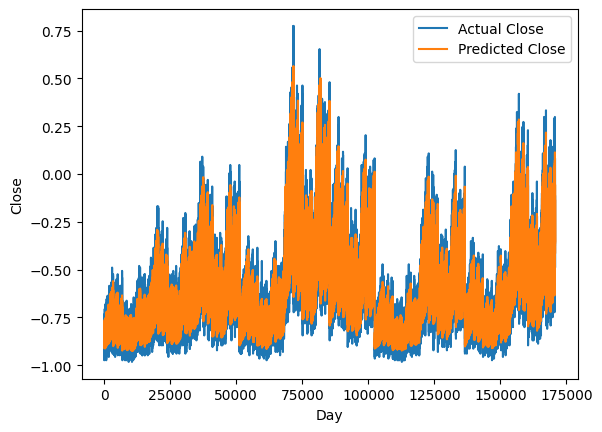

In [119]:
import torch
import matplotlib.pyplot as plt

model_1.to(device)
tensor_X_test = tensor_X_test.to(device)
tensor_Y_test = tensor_Y_test.to(device)

batch_size = 256
predictions = []

with torch.no_grad():
    model_1.eval()
    for i in range(0, len(tensor_X_test), batch_size):
        X_batch = tensor_X_test[i:i+batch_size]
        preds = model_1(X_batch)
        predictions.append(preds.cpu())

predicted = torch.cat(predictions, dim=0).numpy()
actual = tensor_Y_test.cpu().numpy()

plt.plot(actual, label='Actual Close')
plt.plot(predicted, label='Predicted Close')
plt.xlabel('Day')
plt.ylabel('Close')
plt.legend()
plt.show()


In [120]:
daily_sales_sc = go.Scatter(x = daily_sales['date'], y = daily_sales['sales'])
layout = go.Layout(title='Daily sales', xaxis=dict(title='Date'), yaxis=dict(title='Sales'))
fig = go.Figure(data=[daily_sales_sc], layout=layout)
iplot(fig)

### MODEL 3 – UPDATED LSTM

Ovaj model je duboka LSTM mreža namijenjena predikciji vremenskih serija, sa dodatnim slojevima za poboljšanje učenja i regularizaciju.

* Dva LSTM sloja (lstm1 i lstm2) omogućavaju modelu da uči kompleksnije temporalne obrasce kroz više razina apstrakcije.

* Linearni sloj (fc1) pretvara izlaz LSTM-a u veći latentni prostor (256 neurona), nakon čega slijedi ReLU aktivacija za uvođenje nelinearnosti.

* Dropout sloj (0.5) pomaže u sprečavanju prenaučenosti tako što nasumično isključuje polovinu neurona tokom treninga.

* Završni linearni sloj (fc2) predviđa prodaju za naredni dan na osnovu obrađenih značajki.

Model koristi zadnje stanje sekvence (out[:, -1, :]) iz drugog LSTM sloja za predikciju, čime hvata najrelevantnije informacije iz cijele vremenske serije.

Ova arhitektura je pogodna za složenije obrasce u podacima i daje bolje rezultate na dužim i kompleksnijim vremenskim sekvencama.

In [89]:
# model 3 updated lstm
class StockLSTM(nn.Module):
    def __init__(self):
        super(StockLSTM, self).__init__()
        self.lstm1 = nn.LSTM(input_size=1, hidden_size=128, batch_first=True)
        self.lstm2 = nn.LSTM(input_size=128, hidden_size=128, batch_first=True)
        self.fc1 = nn.Linear(128, 256)
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(0.5)
        self.fc2 = nn.Linear(256, 1)

    def forward(self, x):
        out, _ = self.lstm1(x)
        out, _ = self.lstm2(out)
        out = out[:, -1, :]            # uzmi zadnje stanje sekvence
        out = self.fc1(out)
        out = self.relu(out)
        out = self.dropout(out)
        out = self.fc2(out)
        return out

### Ponavljamo treniranje modela na isti nacin. I gledamo rezultate.

In [90]:
model_2 = StockLSTM()
model_2.to(device)
model_2

learning_rate = 0.001
num_epochs = 5
loss_function = nn.L1Loss()
optimizer = torch.optim.Adam(model_2.parameters(), lr=learning_rate)

for epoch in tqdm(range(num_epochs)):
    train_step(model=model_2,
               dataloader=train_dataloader,
               loss_fn=loss_function,
               optimizer=optimizer,
               device=device
              )
    validate_epoch(model_2,test_dataloader, loss_function,device)

  0%|          | 0/5 [00:00<?, ?it/s]

Batch 1, Loss: 0.490
Batch 101, Loss: 14.546
Batch 201, Loss: 9.628
Batch 301, Loss: 9.319
Batch 401, Loss: 9.199
Batch 501, Loss: 9.015
Batch 601, Loss: 8.649
Batch 701, Loss: 8.223
Batch 801, Loss: 8.048
Batch 901, Loss: 7.801
Batch 1001, Loss: 7.356
Batch 1101, Loss: 7.212
Batch 1201, Loss: 7.097
Batch 1301, Loss: 7.066
Batch 1401, Loss: 6.842
Batch 1501, Loss: 6.902
Batch 1601, Loss: 6.723
Batch 1701, Loss: 6.713
Batch 1801, Loss: 6.574
Batch 1901, Loss: 6.583
Batch 2001, Loss: 6.647
Batch 2101, Loss: 6.444
Batch 2201, Loss: 6.547
Batch 2301, Loss: 6.396
Batch 2401, Loss: 6.358
Batch 2501, Loss: 6.308
Batch 2601, Loss: 6.299
Val Loss: 0.051
***************************************************

Batch 1, Loss: 0.065
Batch 101, Loss: 6.273
Batch 201, Loss: 6.236
Batch 301, Loss: 6.190
Batch 401, Loss: 6.143
Batch 501, Loss: 6.139
Batch 601, Loss: 6.139
Batch 701, Loss: 6.072
Batch 801, Loss: 6.019
Batch 901, Loss: 6.128
Batch 1001, Loss: 6.098
Batch 1101, Loss: 6.048
Batch 1201, Loss: 

In [91]:
# test 2
epochs = 2
batch_size = 32

model_2.to(device)
for epoch in range(epochs):
    model_2.train()
    permutation = torch.randperm(tensor_X_train.size(0))

    running_loss = 0.0
    for i in range(0, tensor_X_train.size(0), batch_size):
        indices = permutation[i:i+batch_size]
        batch_x, batch_y = tensor_X_train[indices].to(device), tensor_Y_train[indices].to(device)

        optimizer.zero_grad()
        outputs = model_2(batch_x)
        loss = loss_fn(outputs, batch_y)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    print(f"Epoch [{epoch+1}/{epochs}], Loss: {running_loss/len(tensor_X_train):.4f}")
# for epoch in tqdm(range(epochs)):
#     train_step(model=model_2.to(device),
#                dataloader=train_dataloader,
#                loss_fn=loss_function,
#                optimizer=optimizer,
#                device=device
#               )
#     validate_epoch(model_2,test_dataloader, loss_function,device)

Epoch [1/2], Loss: 0.0002
Epoch [2/2], Loss: 0.0002


Opet ponavljamo isti tip vizualizacije.

Ovo je spoj prodaje iz svih prodavnica i za sve iteme, sluzice nam samo da vidimo koliko je nasa narandzasta linija pokrila plavih a u nastavku cemo napraviti preciznije vizualizacije.

I sada vidimo da je ovaj model vec bolji (po odnosu narandzastih i plavih linija)

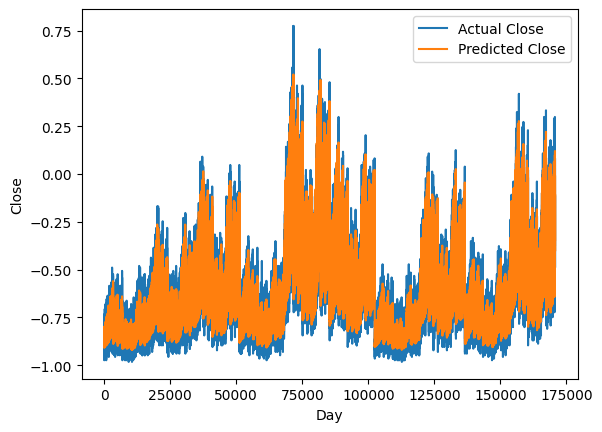

In [92]:
# # validate res
import torch
import matplotlib.pyplot as plt

model_2.to(device)
tensor_X_test = tensor_X_test.to(device)
tensor_Y_test = tensor_Y_test.to(device)

batch_size = 256
predictions = []

with torch.no_grad():
    model_2.eval()
    for i in range(0, len(tensor_X_test), batch_size):
        X_batch = tensor_X_test[i:i+batch_size]
        preds = model_2(X_batch)
        predictions.append(preds.cpu())

predicted = torch.cat(predictions, dim=0).numpy()
actual = tensor_Y_test.cpu().numpy()

plt.plot(actual, label='Actual Close')
plt.plot(predicted, label='Predicted Close')
plt.xlabel('Day')
plt.ylabel('Close')
plt.legend()
plt.show()

In [93]:
data = series_to_supervised(train_gp.drop('date', axis=1), window=window, lag=lag)

data = data[(data['store(t+%d)' % lag] == data[last_store])]
data = data[(data['item(t+%d)'  % lag] == data[last_item ])]

data = data[(data['store(t)'] == data[last_store])]
data = data[(data['item(t)'] == data[last_item])]

print(data.shape)
data.head()


   item  store  sales
0     1      1   13.0
1     1      1   11.0
2     1      1   14.0
3     1      1   13.0
4     1      1   10.0
(853500, 93)


,item(t-29),store(t-29),sales(t-29),item(t-28),store(t-28),sales(t-28),item(t-27),store(t-27),sales(t-27),item(t-26),...,sales(t-2),item(t-1),store(t-1),sales(t-1),item(t),store(t),sales(t),item(t+90),store(t+90),sales(t+90)
29,1.0,1.0,13.0,1.0,1.0,11.0,1.0,1.0,14.0,1.0,...,11.0,1.0,1.0,6.0,1,1,9.0,1.0,1.0,15.0
30,1.0,1.0,11.0,1.0,1.0,14.0,1.0,1.0,13.0,1.0,...,6.0,1.0,1.0,9.0,1,1,13.0,1.0,1.0,16.0
31,1.0,1.0,14.0,1.0,1.0,13.0,1.0,1.0,10.0,1.0,...,9.0,1.0,1.0,13.0,1,1,11.0,1.0,1.0,23.0
32,1.0,1.0,13.0,1.0,1.0,10.0,1.0,1.0,12.0,1.0,...,13.0,1.0,1.0,11.0,1,1,21.0,1.0,1.0,22.0
33,1.0,1.0,10.0,1.0,1.0,12.0,1.0,1.0,10.0,1.0,...,11.0,1.0,1.0,21.0,1,1,15.0,1.0,1.0,20.0


# ITEM - STORE Vizaulizacija
Graf omogućava vizualnu procjenu tačnosti modela za konkretan proizvod u konkretnoj prodavnici.

Može se vidjeti koliko dobro model prati stvarni trend, da li kasni, precjenjuje ili podcjenjuje prodaju u određenim danima.

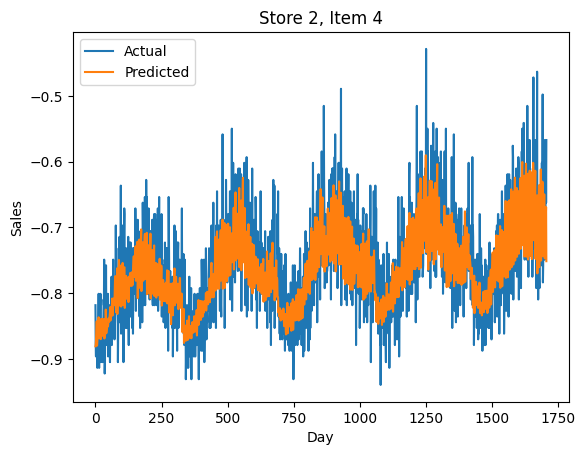

In [109]:
store_item = (2, 4)
data = data.iloc[:split_index]
indices = (data['store(t)'] == store_item[0]) & (data['item(t)'] == store_item[1])
indices.shape, actual.shape

plt.plot(actual[indices], label='Actual')
plt.plot(predicted[indices], label='Predicted')
plt.title(f'Store {store_item[0]}, Item {store_item[1]}')
plt.xlabel('Day')
plt.ylabel('Sales')
plt.legend()
plt.show()

# Distribucija grešaka modela.

errors = predicted - actual računa razliku između predikcija i stvarnih vrijednosti.

Histogram (plt.hist) pokazuje koliko često se javljaju različite vrijednosti grešaka.

Osa x predstavlja veličinu greške, osa y broj pojavljivanja.

Graf omogućava brzu procjenu koliko model precizno predviđa i da li greške imaju tendenciju prema pozitivnim ili negativnim vrijednostima.



# **Zaključak**
Histogram pokazuje da je model dobar i stabilan, jer većina predikcija blizu stvarnih vrijednosti i greške nisu sistematski pomaknute.

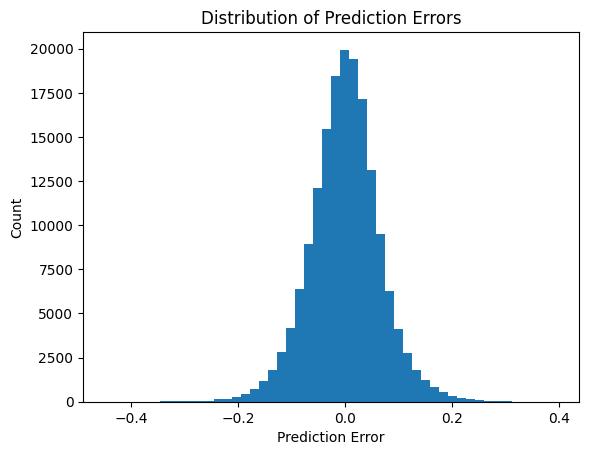

In [95]:
errors = predicted - actual
plt.hist(errors, bins=50)
plt.xlabel('Prediction Error')
plt.ylabel('Count')
plt.title('Distribution of Prediction Errors')
plt.show()

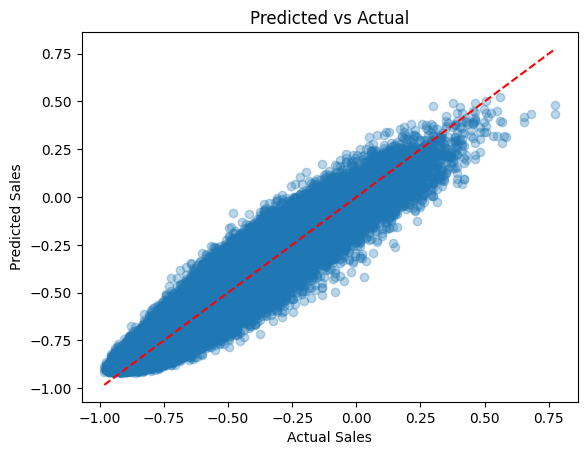

In [96]:
plt.scatter(actual, predicted, alpha=0.3)
plt.plot([actual.min(), actual.max()], [actual.min(), actual.max()], 'r--')
plt.xlabel('Actual Sales')
plt.ylabel('Predicted Sales')
plt.title('Predicted vs Actual')
plt.show()

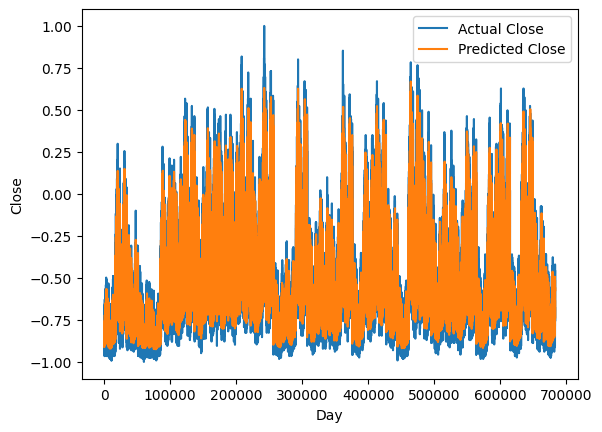

In [97]:
# # validate res
import torch
import matplotlib.pyplot as plt

model_2.to(device)
tensor_X_train = tensor_X_train.to(device)
tensor_Y_train = tensor_Y_train.to(device)

batch_size = 256
predictions = []

with torch.no_grad():
    model_2.eval()
    for i in range(0, len(tensor_X_train), batch_size):
        X_batch = tensor_X_train[i:i+batch_size]
        preds = model_2(X_batch)
        predictions.append(preds.cpu())

predicted = torch.cat(predictions, dim=0).numpy()
actual = tensor_Y_train.cpu().numpy()

plt.plot(actual, label='Actual Close')
plt.plot(predicted, label='Predicted Close')
plt.xlabel('Day')
plt.ylabel('Close')
plt.legend()
plt.show()

In [98]:
print(actual[0])
actual_unscaled = (actual.flatten() + 1) / 2 * (scaler.data_max_[-1] - scaler.data_min_[-1]) + scaler.data_min_[-1]
predicted_unscaled = (predicted.flatten() + 1) / 2 * (scaler.data_max_[-1] - scaler.data_min_[-1]) + scaler.data_min_[-1]
# predicted_unscaled.shape, actual_unscaled.shape, predicted_unscaled[0]
print(actual_unscaled[1], scaler.data_max_[-1], scaler.data_min_[-1], scaler.data_min_[-1])





[-0.88744587]
10.999999344348907 231.0 0.0 0.0


In [99]:
daily_sales['date'][0], predicted[0].item()

x_values = list(range(len(predicted)))
print(predicted.shape)
trace_actual = go.Scatter(
    x=x_values,
    y=actual_unscaled,
    mode='lines',
    name='Actual'
)

trace_predicted = go.Scatter(
    x=x_values,
    y=predicted_unscaled,
    mode='lines',
    name='Predicted'
)

layout = go.Layout(
    title='Predicted vs Actual',
    xaxis=dict(title='Day'),
    yaxis=dict(title='Value')
)

fig = go.Figure(data=[trace_actual, trace_predicted], layout=layout)
iplot(fig)

(682800, 1)


In [100]:
print(len(train), split_index)
sales_by_store_by_item = train.groupby(by=['date', 'store','item'], as_index=False)['sales'].sum()
sales_by_store_by_item = sales_by_store_by_item[(sales_by_store_by_item['item'] == 1)]
sales_by_store_by_item = sales_by_store_by_item[(sales_by_store_by_item['store'] == 1)]

store_daily_sales_sc = []
store_daily_sales_sc.append(go.Scatter(x=sales_by_store_by_item['date'], y=sales_by_store_by_item['sales'], name=('Store %s' % 1)))
sales_by_store_by_item.head(),  sales_by_store_by_item.shape

layout = go.Layout(title='Store 1 daily sales item 1', xaxis=dict(title='Date'), yaxis=dict(title='Sales'))
fig = go.Figure(data=store_daily_sales_sc, layout=layout)
iplot(fig)
current_store_daily_sales.head()

913000 682800


,date,store,sales
9,2013-01-01,10,1521
19,2013-01-02,10,1530
29,2013-01-03,10,1654
39,2013-01-04,10,1739
49,2013-01-05,10,1841
